<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Setup" data-toc-modified-id="Setup-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Setup</a></span><ul class="toc-item"><li><span><a href="#List-of-things-to-import" data-toc-modified-id="List-of-things-to-import-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>List of things to import</a></span></li><li><span><a href="#Importing/Exploring-the-data" data-toc-modified-id="Importing/Exploring-the-data-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Importing/Exploring the data</a></span><ul class="toc-item"><li><span><a href="#Exploring-features'-info-and-value-counts" data-toc-modified-id="Exploring-features'-info-and-value-counts-1.2.1"><span class="toc-item-num">1.2.1&nbsp;&nbsp;</span>Exploring features' info and value counts</a></span></li></ul></li><li><span><a href="#Data-Cleaning" data-toc-modified-id="Data-Cleaning-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Data Cleaning</a></span><ul class="toc-item"><li><span><a href="#Cleaning-missing-values" data-toc-modified-id="Cleaning-missing-values-1.3.1"><span class="toc-item-num">1.3.1&nbsp;&nbsp;</span>Cleaning missing values</a></span></li><li><span><a href="#Check-for-Multicollinearity" data-toc-modified-id="Check-for-Multicollinearity-1.3.2"><span class="toc-item-num">1.3.2&nbsp;&nbsp;</span>Check for Multicollinearity</a></span></li><li><span><a href="#Checking-for-Categorical-Features" data-toc-modified-id="Checking-for-Categorical-Features-1.3.3"><span class="toc-item-num">1.3.3&nbsp;&nbsp;</span>Checking for Categorical Features</a></span></li><li><span><a href="#Converting-features-to-categorical-variables" data-toc-modified-id="Converting-features-to-categorical-variables-1.3.4"><span class="toc-item-num">1.3.4&nbsp;&nbsp;</span>Converting features to categorical variables</a></span></li></ul></li></ul></li><li><span><a href="#Questions-to-Explore" data-toc-modified-id="Questions-to-Explore-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Questions to Explore</a></span><ul class="toc-item"><li><span><a href="#Does-a-waterfront-view-affect-prices-in-anyway?" data-toc-modified-id="Does-a-waterfront-view-affect-prices-in-anyway?-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Does a waterfront view affect prices in anyway?</a></span></li><li><span><a href="#Does-zipcode/location-effect-house-prices-in-anyway?" data-toc-modified-id="Does-zipcode/location-effect-house-prices-in-anyway?-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Does zipcode/location effect house prices in anyway?</a></span></li><li><span><a href="#Does-sqft_living-affect-prices-in-anyway?" data-toc-modified-id="Does-sqft_living-affect-prices-in-anyway?-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Does sqft_living affect prices in anyway?</a></span></li></ul></li><li><span><a href="#Modeling" data-toc-modified-id="Modeling-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Modeling</a></span><ul class="toc-item"><li><span><a href="#Model-Attempt-1---Simple-Linear-Regression" data-toc-modified-id="Model-Attempt-1---Simple-Linear-Regression-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Model Attempt 1 - Simple Linear Regression</a></span></li><li><span><a href="#Model-Attempt-2---Stepwise-Selection" data-toc-modified-id="Model-Attempt-2---Stepwise-Selection-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Model Attempt 2 - Stepwise Selection</a></span></li><li><span><a href="#Model-Attempt-3---Interactions" data-toc-modified-id="Model-Attempt-3---Interactions-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Model Attempt 3 - Interactions</a></span></li></ul></li><li><span><a href="#Regression-Model-Validation" data-toc-modified-id="Regression-Model-Validation-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Regression Model Validation</a></span></li><li><span><a href="#Conclusion" data-toc-modified-id="Conclusion-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Conclusion</a></span></li></ul></div>

<font size="6">**Final Project Submission**</font>

Please fill out:
* Student name: Andy Peng
* Student pace: part time
* Scheduled project review date/time: 
* Instructor name: Victor Geislinger
* Blog post URL: https://medium.com/@andypeng93/data-visualizations-for-zip-codes-2bbf1e16cab0


I am tasked to investigate housing prices for a company that is focus on finding affordable family houses in the King County area. For this project we will be using the King County Housing Sales dataset to investigate different features that might affect the housing prices. By using the kc_house_data.csv dataset we will be trying to find certain features that we should keep our eyes out to get the best prices for family houses. 

# Setup

## List of things to import

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import numpy as np
from itertools import combinations
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from scipy import stats
import matplotlib.cm as cm
import folium
from folium.plugins import MarkerCluster

def stepwise_selection(X, y, 
                       initial_list=[], 
                       threshold_in=0.01, 
                       threshold_out = 0.05, 
                       verbose=True):
    """ Perform a forward-backward feature selection 
    based on p-value from statsmodels.api.OLS
    Arguments:
        X - pandas.DataFrame with candidate features
        y - list-like with the target
        initial_list - list of features to start with (column names of X)
        threshold_in - include a feature if its p-value < threshold_in
        threshold_out - exclude a feature if its p-value > threshold_out
        verbose - whether to print the sequence of inclusions and exclusions
    Returns: list of selected features 
    Always set threshold_in < threshold_out to avoid infinite looping.
    See https://en.wikipedia.org/wiki/Stepwise_regression for the details
    """
    included = list(initial_list)
    while True:
        changed=False
        # forward step
        excluded = list(set(X.columns)-set(included))
        new_pval = pd.Series(index=excluded)
        for new_column in excluded:
            model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included+[new_column]]))).fit()
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed=True
            if verbose:
                pass
#                 print('Add  {:30} with p-value {:.6}'.format(best_feature, best_pval))

        # backward step
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max() # null if pvalues is empty
        if worst_pval > threshold_out:
            changed=True
            worst_feature = pvalues.argmax()
            included.remove(worst_feature)
            if verbose:
                pass
#                 print('Drop {:30} with p-value {:.6}'.format(worst_feature, worst_pval))
        if not changed:
            break
    return included

## Importing/Exploring the data 

In [2]:
data = pd.read_csv('kc_house_data.csv')
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


### Exploring features' info and value counts

In [3]:
data.info()
# waterfront, view, yr_renovated having missing data. 
# sqft_basement, date is an object, while the rest are float/int values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
id               21597 non-null int64
date             21597 non-null object
price            21597 non-null float64
bedrooms         21597 non-null int64
bathrooms        21597 non-null float64
sqft_living      21597 non-null int64
sqft_lot         21597 non-null int64
floors           21597 non-null float64
waterfront       19221 non-null float64
view             21534 non-null float64
condition        21597 non-null int64
grade            21597 non-null int64
sqft_above       21597 non-null int64
sqft_basement    21597 non-null object
yr_built         21597 non-null int64
yr_renovated     17755 non-null float64
zipcode          21597 non-null int64
lat              21597 non-null float64
long             21597 non-null float64
sqft_living15    21597 non-null int64
sqft_lot15       21597 non-null int64
dtypes: float64(8), int64(11), object(2)
memory usage: 3.5+ MB


## Data Cleaning

In [4]:
# For this project since we haven't had much practice in interpreting location and time we shall leave these out
# Dropping date, lat, long
data = data.drop(['date', 'lat', 'long'], axis = 1)

In [5]:
data = data.drop(['yr_renovated', 'id', 'view'], axis = 1)
# Dropping yr_renovated because majority of the houses were not renovated. 
# yr_renovated - 17011 out of the 17755 were not renovated.

# Dropping id because we will not be considering houses with same id. In other words since the houses were bought and sold
# after a period of time, this might be due to inflation.

# Dropping view because I don't think the number of people that came in to view the house would affect the house price.

In [6]:
# I will not be considering house prices above 1 million because a typical family
# would not be investing more than a 1 million for a family house.
data = data[data['price'] <= 1000000.0]
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20139 entries, 0 to 21596
Data columns (total 15 columns):
price            20139 non-null float64
bedrooms         20139 non-null int64
bathrooms        20139 non-null float64
sqft_living      20139 non-null int64
sqft_lot         20139 non-null int64
floors           20139 non-null float64
waterfront       17912 non-null float64
condition        20139 non-null int64
grade            20139 non-null int64
sqft_above       20139 non-null int64
sqft_basement    20139 non-null object
yr_built         20139 non-null int64
zipcode          20139 non-null int64
sqft_living15    20139 non-null int64
sqft_lot15       20139 non-null int64
dtypes: float64(4), int64(10), object(1)
memory usage: 2.5+ MB


### Cleaning missing values

* bedrooms - The average family would not be purchasing houses with more than 6 bedrooms.
* sqft_basement - There are ? values and it requires some data cleaning.

Waterfront variable has some missing values and sqft_basement has values with ?.

In [7]:
# Filling waterfront missing data randomly with proportion of 0's and 1's.
zl = len(data[data['waterfront'] == 0.0])
ol = len(data[data['waterfront'] == 1.0])
l = len(data) - len(data[data['waterfront'].isna()])

data['waterfront'] = data['waterfront'].fillna((np.random.choice([0, 1], p=[zl/l, ol/l])))
data['waterfront'].value_counts()

0.0    20089
1.0       50
Name: waterfront, dtype: int64

In [8]:
# Going to fill the question mark values with 0 because majority of the values are 0's and also convert it to integers.
data['sqft_basement'] = data['sqft_basement'].replace(to_replace = '?', value = 0.0)
data['sqft_basement'] = data['sqft_basement'].astype(str).astype(float)

Since our goal is to find affordable family houses, we will be dropping building grade values of 13. According to this [link](https://info.kingcounty.gov/assessor/esales/Glossary.aspx?type=r#c), building grade 13 is a mansion level that is generally custom designed and built.

In [9]:
data = data[data['grade'] != 13]

In [10]:
z_scores = stats.zscore(data.drop(['waterfront'], axis = 1))

abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
new_df = data[filtered_entries]

### Check for Multicollinearity

In [11]:
# Checking for multicollinearity
abs(new_df.corr())> 0.70

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,sqft_basement,yr_built,zipcode,sqft_living15,sqft_lot15
price,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
bedrooms,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False
bathrooms,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False
sqft_living,False,False,False,True,False,False,False,False,False,True,False,False,False,True,False
sqft_lot,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True
floors,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False
waterfront,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False
condition,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
grade,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
sqft_above,False,False,False,True,False,False,False,False,False,True,False,False,False,True,False


The above table shows the correlations between features. We are doing this to check for any multicollinearity between features. I will be getting rid of features greater than 0.70 to avoid multicollinearity between variables. From the above table we can see that the following have multicollinearity issues
1. sqft_living & sqft_above
3. sqft_living & sqft_living15
4. sqft_lot & sqft_lot15
6. sqft_above & sqft_living15

We will be dropping sqft_above, sqft_living15 and sqft_lot15 because these three features have a correlation of 0.70 or higher with other features. 

In [12]:
new_df = new_df.drop(['sqft_above', 'sqft_living15', 'sqft_lot15'], axis = 1)

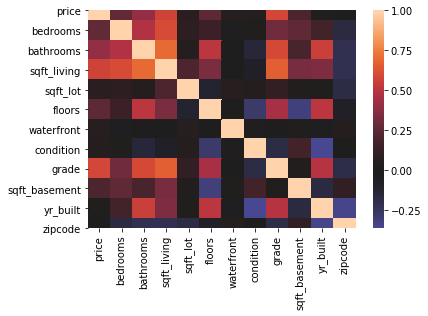

In [13]:
sns.heatmap(new_df.corr(), center=0);

### Checking for Categorical Features

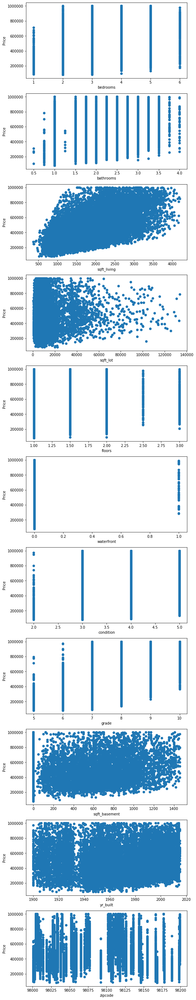

In [14]:
scatterplot_data = new_df.drop(['price'], axis = 1)
fig, axs = plt.subplots(11, figsize = (8, 50))
for index, col in enumerate(scatterplot_data.columns):
    axs[index].scatter(scatterplot_data[col], new_df['price'])
    axs[index].set_ylabel('Price')
    axs[index].set_xlabel(col)

We have graphed each feature against the Price variable which is our target variable in this project. Based on the scatter plots above, the only continuous variables are the following:
1. sqft_living
2. sqft_lot
3. sqft_basement
4. yr_built

However, we will be considering the following features to be continuous also in our calculations. 
1. bathrooms
2. grade

For categorical variables, I will be considering waterfront, bedrooms, conditions, floors and zip codes as categorical variables.

### Converting features to categorical variables

In [15]:
waterfront = new_df.waterfront.astype('category')
waterfront_dummy = pd.get_dummies(waterfront, prefix = 'waterfront', drop_first = True)

In [16]:
bedrooms = new_df.bedrooms.astype('category')
bedroom_dummies = pd.get_dummies(bedrooms, prefix = 'bedroom', drop_first = True)
# 10 columns

In [17]:
conditions = new_df.condition.astype('category')
condition_dummies = pd.get_dummies(conditions, prefix = 'condition', drop_first = True)

In [18]:
floors = new_df.floors.astype('category')
floors_dummies = pd.get_dummies(floors, prefix = 'floor', drop_first = True)

In [19]:
zipcodes = new_df.zipcode.astype('category')
zipcodes_dummies = pd.get_dummies(zipcodes, prefix = 'zip', drop_first = True)

In [20]:
df = new_df.drop(['waterfront', 'bedrooms', 'zipcode', 'condition', 'floors'], axis = 1)
df = pd.concat([df, waterfront_dummy, bedroom_dummies, zipcodes_dummies, condition_dummies, floors_dummies], axis = 1)

# Questions to Explore

Below are some of the questions that I want to investigate on in order to find out which features affect the housing prices the most.

## Does a waterfront view affect prices in anyway?

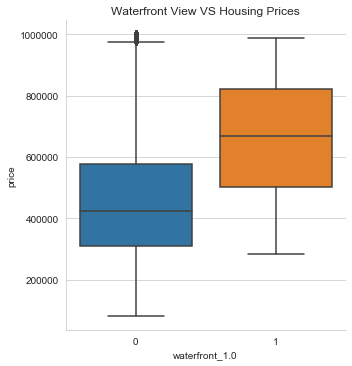

In [21]:
# Box plot comparison of house prices with no waterfront view vs house prices with waterfront view.
sns.set_style("whitegrid") 
ax = sns.catplot(x="waterfront_1.0", y="price", kind="box", data=df)
plt.title('Waterfront View VS Housing Prices')
plt.savefig('WaterFrontView.png',dpi=300, bbox_inches = "tight")

We can see the above boxplot that not having a waterfront view provides significantly lower minimum, median, Q1 and Q3 values than than having a waterfront view. However, We can see that there are still outliers in the prices for not having a waterfront view.

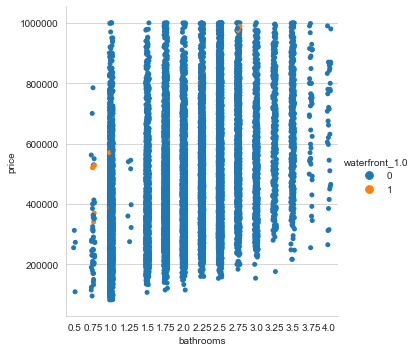

In [22]:
ax = sns.catplot(x='bathrooms', y="price", hue = 'waterfront_1.0', data=df);

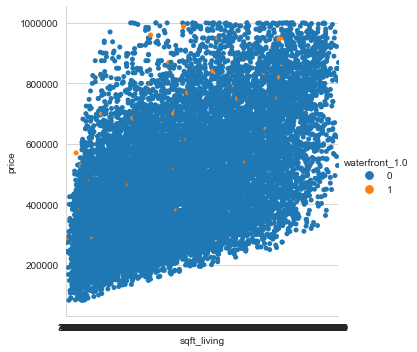

In [23]:
ax = sns.catplot(x='sqft_living', y="price", hue = 'waterfront_1.0', data=df);

## Does zipcode/location effect house prices in anyway?

In [24]:
zip_df = new_df
zip_df.zipcode = zip_df.zipcode.astype(int)

In [25]:
zipcode_means = []
for i in zip_df.zipcode.unique().tolist():
    val = new_df[new_df['zipcode'] == int(i)]['price'].mean()
    zipcode_means.append([str(i), val])

In [26]:
def sortSecond(val): 
    return val[1] 
zipcode_means.sort(key = sortSecond, reverse = True)

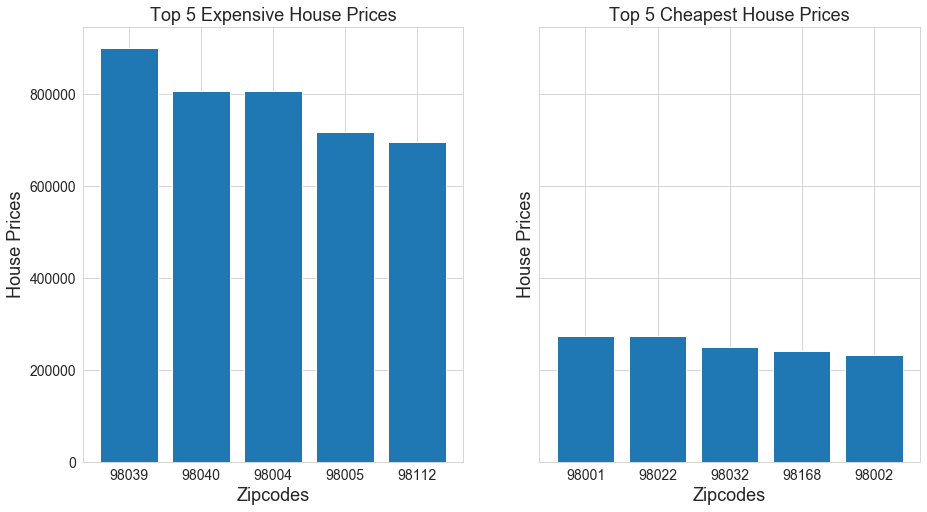

In [27]:
xtop = []
ytop = []
xlow = []
ylow = []
for val in zipcode_means[:5]:
    xtop.append(val[0])
    ytop.append(val[1])
for val in zipcode_means[-5:]:
    xlow.append(val[0])
    ylow.append(val[1])
fig, (ax1, ax2) = plt.subplots(1, 2, sharey = True, figsize = (15, 8))

ax1.bar(xtop, ytop)
ax1.set_title("Top 5 Expensive House Prices", fontsize = 18)
ax1.set_ylabel('House Prices', fontsize = 18)
ax1.set_xlabel('Zipcodes', fontsize = 18)
ax1.tick_params(axis='both', which='major', labelsize=14)

ax2.bar(xlow, ylow)
ax2.set_title("Top 5 Cheapest House Prices", fontsize = 18)
ax2.set_ylabel('House Prices', fontsize = 18)
ax2.set_xlabel('Zipcodes', fontsize = 18)
ax2.tick_params(axis='both', which='major', labelsize=14)

plt.savefig('zipcodes.png')

We can see that there is a huge difference in average house prices when comparing different zipcode locations. We will display the zipcodes and average house prices on a map and see where the locations are on the map. After that we will be investigating if other features have an interaction with zipcodes.

In [28]:
map = folium.Map(location=[47.5112, -122.257], default_zoom_start=15)

In [29]:
lattrial = [47.627, 47.569, 47.618, 47.611, 47.630, 47.304, 47.194, 47.388, 47.491, 47.304]
longtrial = [-122.233, -122.232, -122.203, -122.169, -122.298, -122.266, -121.919, -122.259, -122.303, -122.216]

In [30]:
# Try to create a new data frame holding the zipcodes and the mean price.
xtrial = xtop + xlow
ytrial = ytop + ylow
trial_df = pd.DataFrame(list(zip(xtrial, ytrial, lattrial, longtrial)), columns = ['Zipcode', 'Price', 'Lat', 'Long'])

In [31]:
map.choropleth(geo_data="zip_codes.geojson",
             data=trial_df, # my dataset
             columns=['Zipcode', 'Price'], # zip code is here for matching the geojson zipcode, sales price is the column that changes the color of zipcode areas
             key_on='feature.properties.ZIPCODE', # this path contains zipcodes in str type, this zipcodes should match with our ZIP CODE column
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='SALE PRICE')

C:\Users\andyp\AppData\Local\Continuum\anaconda3\envs\learn-env\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [61]:
# marker_cluster = MarkerCluster().add_to(map) # create marker clusters

# for i in range(trial_df.shape[0]):
#     location = [trial_df['Lat'][i],trial_df['Long'][i]]
#     tooltip = "Zipcode:{}".format(trial_df["Zipcode"][i])
    
#     folium.Marker(location, # adding more details to the popup screen using HTML
#                   popup="""
#                   <i>Mean sales price: </i> <br> <b>${}</b> 
#                   """.format(
#                     round(trial_df['Price'][i],2)), 
#                   tooltip=tooltip).add_to(marker_cluster)

In [33]:
df1 = pd.read_csv('kc_house_data.csv')
df1 = df1.drop(['date', 'yr_renovated', 'id', 'view'], axis = 1)
df1 = df1[df1['price'] <= 1000000.0]
zl = len(df1[df1['waterfront'] == 0.0])
ol = len(df1[df1['waterfront'] == 1.0])
l = len(df1) - len(df1[df1['waterfront'].isna()])

df1['waterfront'] = df1['waterfront'].fillna((np.random.choice([0, 1], p=[zl/l, ol/l])))
df1['waterfront'].value_counts()
df1['sqft_basement'] = df1['sqft_basement'].replace(to_replace = '?', value = 0.0)
df1['sqft_basement'] = df1['sqft_basement'].astype(str).astype(float)
df1 = df1[df1['grade'] != 13]
z_scores = stats.zscore(df1.drop(['waterfront'], axis = 1))

abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
new_df1 = df1[filtered_entries]
dfmap = new_df1[['zipcode', 'price', 'long', 'lat']]
#Create the dataframe containing the data we want.
dfmap.zipcode = dfmap.zipcode.astype(int)
zipcode_means = []
for i in dfmap.zipcode.unique().tolist():
    val = dfmap[dfmap['zipcode'] == i]['price'].mean()
    lat = dfmap[dfmap['zipcode'] == i]['lat'].mean()
    long = dfmap[dfmap['zipcode'] == i]['long'].mean()
    zipcode_means.append([str(i), val, lat, long])
xall = []
yall = []
latall = []
longall = []
for val in zipcode_means:
    xall.append(val[0])
    yall.append(val[1])
    latall.append(val[2])
    longall.append(val[3])
tdf = pd.DataFrame(list(zip(xall, yall, latall, longall)), columns = ['Zipcode', 'Price', 'Latitude', 'Longitude'])
map1 = folium.Map(location=[47.5112, -122.257], default_zoom_start=15)
map1.choropleth(geo_data="zip_codes.geojson",
                data=tdf, # my dataset
                columns=['Zipcode', 'Price'], # zip code is here for matching the geojson zipcode, sales price is the column that changes the color of zipcode areas
                key_on='feature.properties.ZIPCODE', # this path contains zipcodes in str type, this zipcodes should match with our ZIP CODE column
                fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
                legend_name='SALE PRICE')
marker_cluster = MarkerCluster().add_to(map1) # create marker clusters

for i in range((tdf.shape[0])):
    location = [tdf['Latitude'][i], tdf['Longitude'][i]]
    tooltip = "Zipcode: {}".format(tdf["Zipcode"][i])
    folium.Marker(location, 
                  popup="""
                  <i>Mean sales price: </i> <br> <b>${}</b> 
                  """.format(round(tdf['Price'][i],2)),
                  tooltip=tooltip).add_to(marker_cluster)
map1

C:\Users\andyp\AppData\Local\Continuum\anaconda3\envs\learn-env\lib\site-packages\pandas\core\generic.py:5208: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [34]:
df.loc[df.zip_98112 == 1]['waterfront_1.0'].value_counts()

0    147
Name: waterfront_1.0, dtype: int64

In [35]:
df.loc[df.zip_98039 == 1]['waterfront_1.0'].value_counts()

0    6
Name: waterfront_1.0, dtype: int64

We can see in the above interactive mapping that zip codes closer to Mercer Island on average cost more than zip codes that are farther away. Surprisingly none of the above average housing prices have a waterfront view.

## Does sqft_living affect prices in anyway?

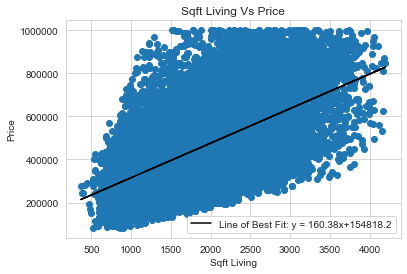

In [36]:
x = df.sqft_living
y = df.price
plt.scatter(x, y)
# We can see a positive correlation.
m, b = np.polyfit(x, y, 1)
plt.plot(x, m*x + b, c = 'black', label = 'Line of Best Fit: y = {}x+{}'.format(round(m, 2), round(b, 2)))
plt.title('Sqft Living Vs Price')
plt.xlabel('Sqft Living')
plt.ylabel('Price')
plt.legend()
plt.savefig('SqftLivingPrice.png',dpi=300, bbox_inches = "tight")

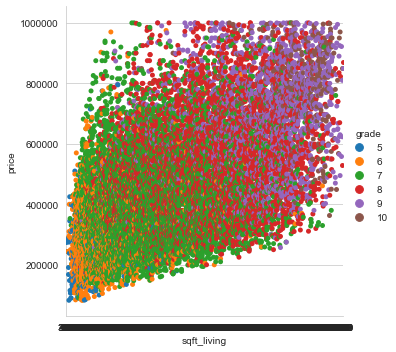

In [37]:
ax = sns.catplot(x='sqft_living', y="price", hue = 'grade', data=df);

As we can see above the footage of the house has a positive correlation with the housing prices. Notice also as the grade increase the price and square footage of the house also increase. 

# Modeling

## Model Attempt 1 - Simple Linear Regression

In [38]:
X = df.drop(['price'], axis = 1)
y = df['price']

In [47]:
predictors_int = sm.add_constant(X)
model1 = sm.OLS(df['price'],predictors_int).fit()
model1.rsquared_adj

0.8167283113582883

## Model Attempt 2 - Stepwise Selection

In [40]:
stepwise_selection(X, y)

C:\Users\andyp\AppData\Local\Continuum\anaconda3\envs\learn-env\lib\site-packages\ipykernel_launcher.py:60: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.


['sqft_living',
 'grade',
 'yr_built',
 'zip_98023',
 'zip_98004',
 'zip_98092',
 'zip_98042',
 'zip_98003',
 'zip_98033',
 'zip_98040',
 'zip_98115',
 'zip_98103',
 'zip_98117',
 'zip_98199',
 'zip_98112',
 'zip_98119',
 'zip_98030',
 'zip_98031',
 'zip_98105',
 'zip_98107',
 'zip_98052',
 'zip_98116',
 'zip_98006',
 'zip_98005',
 'zip_98122',
 'zip_98109',
 'zip_98053',
 'zip_98102',
 'zip_98008',
 'zip_98136',
 'zip_98075',
 'zip_98074',
 'zip_98029',
 'zip_98144',
 'waterfront_1.0',
 'zip_98027',
 'zip_98034',
 'zip_98007',
 'zip_98177',
 'zip_98125',
 'zip_98126',
 'zip_98039',
 'zip_98072',
 'condition_5',
 'sqft_basement',
 'zip_98118',
 'sqft_lot',
 'zip_98133',
 'zip_98155',
 'zip_98065',
 'zip_98028',
 'zip_98011',
 'zip_98077',
 'zip_98002',
 'zip_98032',
 'condition_4',
 'zip_98022',
 'floor_3.0',
 'bathrooms',
 'zip_98106',
 'zip_98056',
 'zip_98146',
 'zip_98166',
 'zip_98059',
 'zip_98108',
 'zip_98045',
 'zip_98019',
 'zip_98024',
 'zip_98014',
 'zip_98070',
 'zip_98010

In [49]:
X = X[['sqft_living',
 'grade',
 'yr_built',
 'zip_98023',
 'zip_98004',
 'zip_98092',
 'zip_98042',
 'zip_98003',
 'zip_98033',
 'zip_98040',
 'zip_98115',
 'zip_98103',
 'zip_98117',
 'zip_98199',
 'zip_98112',
 'zip_98119',
 'zip_98030',
 'zip_98031',
 'zip_98105',
 'zip_98107',
 'zip_98052',
 'zip_98116',
 'zip_98006',
 'zip_98005',
 'zip_98122',
 'zip_98109',
 'zip_98053',
 'zip_98102',
 'zip_98008',
 'zip_98136',
 'zip_98075',
 'zip_98074',
 'zip_98029',
 'zip_98144',
 'waterfront_1.0',
 'zip_98027',
 'zip_98034',
 'zip_98007',
 'zip_98177',
 'zip_98125',
 'zip_98126',
 'zip_98039',
 'zip_98072',
 'condition_5',
 'sqft_basement',
 'zip_98118',
 'sqft_lot',
 'zip_98133',
 'zip_98155',
 'zip_98065',
 'zip_98028',
 'zip_98011',
 'zip_98077',
 'zip_98002',
 'zip_98032',
 'condition_4',
 'zip_98022',
 'floor_3.0',
 'bathrooms',
 'zip_98106',
 'zip_98056',
 'zip_98146',
 'zip_98166',
 'zip_98059',
 'zip_98108',
 'zip_98045',
 'zip_98019',
 'zip_98024',
 'zip_98014',
 'zip_98070',
 'zip_98010',
 'bedroom_5',
 'floor_2.0',
 'zip_98178',
 'condition_3',
 'bedroom_6']]
predictors_int = sm.add_constant(X)
model2 = sm.OLS(df['price'],predictors_int).fit()
model2.rsquared_adj

0.8167283113582883

## Model Attempt 3 - Interactions

In [50]:
# Interactions
regression = LinearRegression()
crossvalidation = KFold(n_splits = 10, shuffle = True)
baseline = np.mean(cross_val_score(regression, X, y, scoring = 'r2', cv = crossvalidation))
print(baseline)
from itertools import combinations
combinations = list(combinations(X, 2))
list_of_interact_r2 = []
for index, c in enumerate(combinations):
    X_interact = X.copy()
    X_interact[index] = X[c[0]] * X[c[1]]
    interact = np.mean(cross_val_score(regression, X_interact, y, scoring = 'r2', cv = crossvalidation))
    list_of_interact_r2.append([c, interact])

0.8152801922469379


In [51]:
list_of_interact_r2.sort(key = lambda x: x[1], reverse = True)
list_of_interact_r2[:3]

[[('sqft_living', 'grade'), 0.8175142110102067],
 [('sqft_living', 'sqft_lot'), 0.8170367893313253],
 [('grade', 'bathrooms'), 0.8169007392276214]]

In [52]:
regression = LinearRegression()
crossvalidation = KFold(n_splits = 10, shuffle = True, random_state = 1)
X_interaction = X.copy()
X_interaction['livinggrade'] = X_interaction['sqft_living'] * X_interaction['grade']
X_interaction['gradebathrooms'] = X_interaction['grade'] * X_interaction['bathrooms']
X_interaction['livinglot'] = X_interaction['sqft_living'] * X_interaction['sqft_lot']

interact_bathrooms_grade = np.mean(cross_val_score(regression, X_interaction, y, scoring = 'r2', cv = crossvalidation))
interact_bathrooms_grade

0.8198972358391444

In [53]:
X_interact = sm.add_constant(X_interaction)
model3 = sm.OLS(y, X_interact)
results = model3.fit()

results.summary()

C:\Users\andyp\AppData\Local\Continuum\anaconda3\envs\learn-env\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.822
Model:                            OLS   Adj. R-squared:                  0.821
Method:                 Least Squares   F-statistic:                     1107.
Date:                Sat, 09 May 2020   Prob (F-statistic):               0.00
Time:                        23:43:50   Log-Likelihood:            -2.4208e+05
No. Observations:               19045   AIC:                         4.843e+05
Df Residuals:                   18965   BIC:                         4.849e+05
Df Model:                          79                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const           9.595e+05   6.78e+04     14.156      0.000    8.27e+05    1.09e+06
sqft_living       25.6062     10.424      2.457      0.014       5.175      46.037
grade           1.784e+04   2285.357      7.808      0.000    1.34e+04    2.23e+04
yr_built        -559.4915     35.289    -15.854      0.000    -628.661    -490.322
zip_98023      -5.028e+04   4041.173    -12.442      0.000   -5.82e+04   -4.24e+04
zip_98004       4.699e+05   7190.490     65.356      0.000    4.56e+05    4.84e+05
zip_98092      -5.026e+04   4959.046    -10.135      0.000      -6e+04   -4.05e+04
zip_98042      -2.515e+04   3935.909     -6.389      0.000   -3.29e+04   -1.74e+04
zip_98003      -3.075e+04   5181.845     -5.935      0.000   -4.09e+04   -2.06e+04
zip_98033        2.82e+05   4718.981     59.750      0.000    2.73e+05    2.91e+05
zip_98040       3.898e+05   7182.662     54.276      0.000    3.76e+05    4.04e+05
zip_98115       2.842e+05   4018.733     70.724      0.000    2.76e+05    2.92e+05
zip_98103       2.905e+05   4157.479     69.880      0.000    2.82e+05    2.99e+05
zip_98117        2.78e+05   4089.987     67.967      0.000     2.7e+05    2.86e+05
zip_98199       3.209e+05   5515.339     58.189      0.000     3.1e+05    3.32e+05
zip_98112       3.783e+05   7042.798     53.712      0.000    3.64e+05    3.92e+05
zip_98119       3.737e+05   7103.175     52.607      0.000     3.6e+05    3.88e+05
zip_98030      -2.596e+04   5388.160     -4.818      0.000   -3.65e+04   -1.54e+04
zip_98031      -2.055e+04   5206.667     -3.948      0.000   -3.08e+04   -1.03e+04
zip_98105       3.366e+05   6694.976     50.278      0.000    3.23e+05     3.5e+05
zip_98107       2.956e+05   5533.339     53.426      0.000    2.85e+05    3.06e+05
zip_98052       2.231e+05   3919.760     56.924      0.000    2.15e+05    2.31e+05
zip_98116       2.691e+05   5101.813     52.749      0.000    2.59e+05    2.79e+05
zip_98006       2.397e+05   4717.038     50.821      0.000     2.3e+05    2.49e+05
zip_98005       3.027e+05   7340.530     41.239      0.000    2.88e+05    3.17e+05
zip_98122       2.775e+05   5469.157     50.740      0.000    2.67e+05    2.88e+05
zip_98109       3.797e+05   9202.224     41.266      0.000    3.62e+05    3.98e+05
zip_98053        2.14e+05   4941.449     43.300      0.000    2.04e+05    2.24e+05
zip_98102       3.639e+05   9435.614     38.567      0.000    3.45e+05    3.82e+05
zip_98008       2.181e+05   5310.215     41.067      0.000    2.08e+05    2.28e+05
zip_98136       2.321e+05   5462.063     42.496      0.000    2.21e+05    2.43e+05
zip_98075       1.976e+05   5307.041     37.240      0.000    1.87e+05    2.08e+05
zip_98074       1.827e+05   4564.909     40.015      0.000    1.74e+05    1.92e+05
zip_98029       1.953e+05   5030.556     38.828      0.000    1.85e+05    2.05e+05
zip_98144   

Our best model has an adjusted R squared of 0.821 which includes 3 of the best interacting features. These are

1) 'grade' and 'sqft_living'

2) 'grade' and 'bathrooms'

3) 'sqft_living' and 'sqft_lot'

However, without the interacting features and just using Stepwise Selection we obtained a model that has an adjusted R squared of 0.817. Let's see how well our model does in predicting house prices.

# Regression Model Validation

In [54]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [55]:
linreg = LinearRegression()
linreg.fit(X_train, y_train)

y_hat_train = linreg.predict(X_train)
y_hat_test = linreg.predict(X_test)

In [56]:
train_residuals = y_hat_train - y_train
test_residuals = y_hat_test - y_test
train_mse = mean_squared_error(y_train, y_hat_train)
test_mse = mean_squared_error(y_test, y_hat_test)
print('Train Mean Squarred Error:', train_mse)
print('Test Mean Squarred Error:', test_mse)

Train Mean Squarred Error: 6600535162.046471
Test Mean Squarred Error: 6551555096.792032


In [57]:
cv_5_results  = np.mean(cross_val_score(linreg, X, y, cv=5,  scoring='neg_mean_squared_error'))
cv_10_results = np.mean(cross_val_score(linreg, X, y, cv=10, scoring='neg_mean_squared_error'))
cv_20_results = np.mean(cross_val_score(linreg, X, y, cv=20, scoring='neg_mean_squared_error'))
display(cv_5_results, cv_10_results, cv_20_results)

-6704667165.579425

-6691198106.185915

-6663204008.905909

In [58]:
np.sqrt(-cv_20_results)

81628.45097700867

In [59]:
cv_5_results_interaction  = np.mean(cross_val_score(linreg, X_interaction, y, cv=5,  scoring='neg_mean_squared_error'))
cv_10_results_interaction = np.mean(cross_val_score(linreg, X_interaction, y, cv=10, scoring='neg_mean_squared_error'))
cv_20_results_interaction = np.mean(cross_val_score(linreg, X_interaction, y, cv=20, scoring='neg_mean_squared_error'))
display(cv_5_results_interaction, cv_10_results_interaction, cv_20_results_interaction)

-6535073861.216959

-6530102803.843631

-6506039948.183179

In [60]:
np.sqrt(-cv_20_results_interaction)

80660.02695377171

Our model with interactions can predict house prices with a 81,000 dollar error interval, while the Stepwise Selection model can predict house prices with a 82,000 dollar error interval.

# Conclusion

To summarize everything above, we created a model that manages to predict housing prices within a $80,000 range. We chose to explore the features waterfront view, zipcode and sqft_living. Below shows the exploration results from the code above.

1) Houses with no waterfront view tend to have a lower average housing price.

2) Zipcodes around certain locations such as Mercer Island tend to cost more than houses away from Mercer Island.

3) The bigger the footage of the home is the more expensive the housing price is.